# Data Visualization
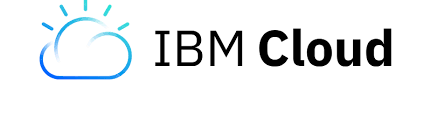

In [7]:
import os
import re
import glob
import numpy as np
import pandas as pd
from IPython.display import Image
import matplotlib.pyplot as plt

plt.style.use('seaborn')
%matplotlib inline

SMALL_SIZE = 12
MEDIUM_SIZE = 14
LARGE_SIZE = 16

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=LARGE_SIZE)   # fontsize of the figure title

## specify the directory you saved the data and images in
os.chdir("./6-ai-production/ai-workflow-capstone")
DATA_DIR = os.path.join(".","data","cs-train","ts-data")
IMAGE_DIR = os.path.join(".","images")

Let's load the data that we will be using to practice EDA and then perform some basic cleanup.

In [40]:
## load the data and print the shape
# df = pd.read_csv(os.path.join(DATA_DIR, "ts-all.csv"), index_col=0)
all_files = glob.glob(DATA_DIR + "/*.csv")

li = []

for filename in all_files:
    df = pd.read_csv(filename, index_col=0)
    country = re.sub("_"," ", os.path.splitext(os.path.basename(filename))[0].rsplit("-")[1]).title()
    if country != 'All':
        df['country'] = country
        li.append(df)

df = pd.concat(li, axis=0, ignore_index=False)

print("df: {} x {}".format(df.shape[0], df.shape[1]))

## clean up the column names
df.columns = [re.sub("\s+","_",col) for col in df.columns.tolist()]
df['year'] = df['year_month'].str.split("-").str[0]
# df = df.drop('year_month', axis=1)

## check the first few rows
df.head(n=4)

df: 5708 x 7


,purchases,unique_invoices,unique_streams,total_views,year_month,revenue,country,year
date,,,,,,,,
2017-11-01,0,0,0,0,2017-11,0.0,Portugal,2017
2017-11-02,0,0,0,0,2017-11,0.0,Portugal,2017
2017-11-03,0,0,0,0,2017-11,0.0,Portugal,2017
2017-11-04,0,0,0,0,2017-11,0.0,Portugal,2017


In [41]:
## missing values summary
print("Missing Value Summary\n{}".format("-"*35))
print(df.isnull().sum(axis = 0))

Missing Value Summary
-----------------------------------
purchases          0
unique_invoices    0
unique_streams     0
total_views        0
year_month         0
revenue            0
country            0
year               0
dtype: int64


In [42]:
## drop the rows that have NaNs
print("Original Matrix:", df.shape)
df.dropna(inplace=True)
print("After NaNs removed:", df.shape)

Original Matrix: (5708, 8)
After NaNs removed: (5708, 8)


## EDA

In [43]:
df.groupby(['country', 'year']).sum()

purchases  unique_invoices  unique_streams  total_views  \
country        year                                                            
Eire           2017        596               30             556         4272   
               2018       9477              438            8844        78421   
               2019       2842              129            2781        22704   
France         2017        337               22             320         2524   
               2018       5874              287            5229        48938   
               2019       3248              193            3087        27923   
Germany        2017        420               29             363         3636   
               2018       8274              506            7592        70323   
               2019       3716              231            3464        30631   
Hong Kong      2018         76                6              74          798   
               2019        184                5             173         1687   
Netherlands    2017        155                6             154         1196   
               2018       2686              146            2619        25757   
               2019       1173               46            1158        12656   
Norway         2017         21                1              21          175   
               2018        495               14             344         5459   
               2019        231               13             218         1803   
Portugal       2017         98                2              98          892   
               2018       1123               59            1025         8298   
               2019        504               28             494         4061   
Singapore      2018        117                4             116         1110   
               2019        118                6             109         1115   
Spain          2017        237                7             133         2192   
               2018       1116               80            1026         8332   
               2019       1072               41            1067         7871   
United Kingdom 2017      42857             2198           21509       191769   
               2018     483120            25301          247811      2404727   
               2019     187159             9902          110299       935669   

                         revenue  
country        year               
Eire           2017     4433.090  
               2018    74398.300  
               2019    25758.010  
France         2017     1200.340  
               2018    24538.340  
               2019    13246.740  
Germany        2017     1525.790  
               2018    30554.331  
               2019    13571.140  
Hong Kong      2018     8715.380  
               2019     5677.750  
Netherlands    2017      384.260  
               2018     8948.110  
               2019     2964.410  
Norway         2017      123.280  
               2018    34716.400  
               2019     3486.440  
Portugal       2017      294.350  
               2018     4292.260  
               2019     8740.600  
Singapore      2018      372.510  
               2019    12572.950  
Spain          2017      845.220  
               2018     7311.560  
               2019     7236.580  
United Kingdom 2017   187241.070  
               2018  2272135.643  
               2019   884174.931

In [44]:
pd.pivot_table(df, index='country', columns='year', values="revenue", aggfunc=np.sum)

year,2017,2018,2019
country,,,
Eire,4433.09,74398.300,25758.010
France,1200.34,24538.340,13246.740
Germany,1525.79,30554.331,13571.140
Hong Kong,NaN,8715.380,5677.750
Netherlands,384.26,8948.110,2964.410
Norway,123.28,34716.400,3486.440
Portugal,294.35,4292.260,8740.600
Singapore,NaN,372.510,12572.950
Spain,845.22,7311.560,7236.580


## Data Visualization

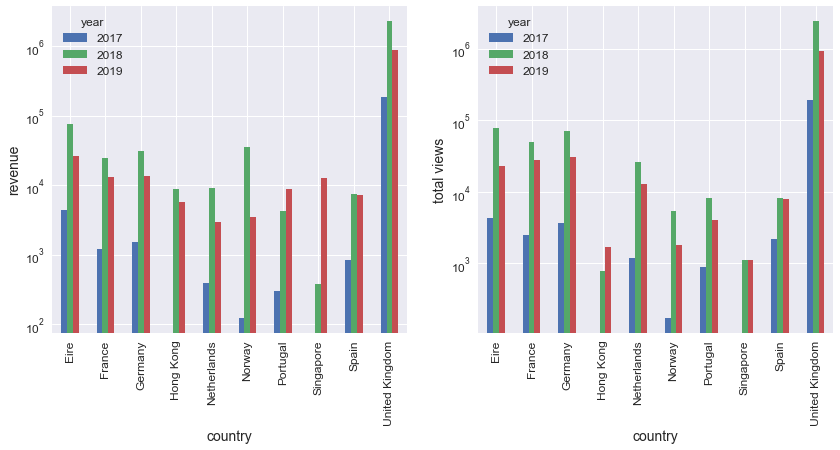

In [45]:
fig = plt.figure(figsize=(14,6))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)

table1 = pd.pivot_table(df, index='country', columns='year', values="revenue", aggfunc=np.sum)
table1.plot(kind='bar', ax=ax1)
ax1.set_ylabel("revenue");

table2 = pd.pivot_table(df, index='country', columns='year', values="total_views", aggfunc=np.sum)
table2.plot(kind='bar', ax=ax2)
ax2.set_ylabel("total views");

## adjust the axis to accomadate the legend
ax1.set_yscale('log')
ax2.set_yscale('log')
# ax1.set_ylim((0,9.3))
# ax2.set_ylim((0,1.3))

### Pair plot

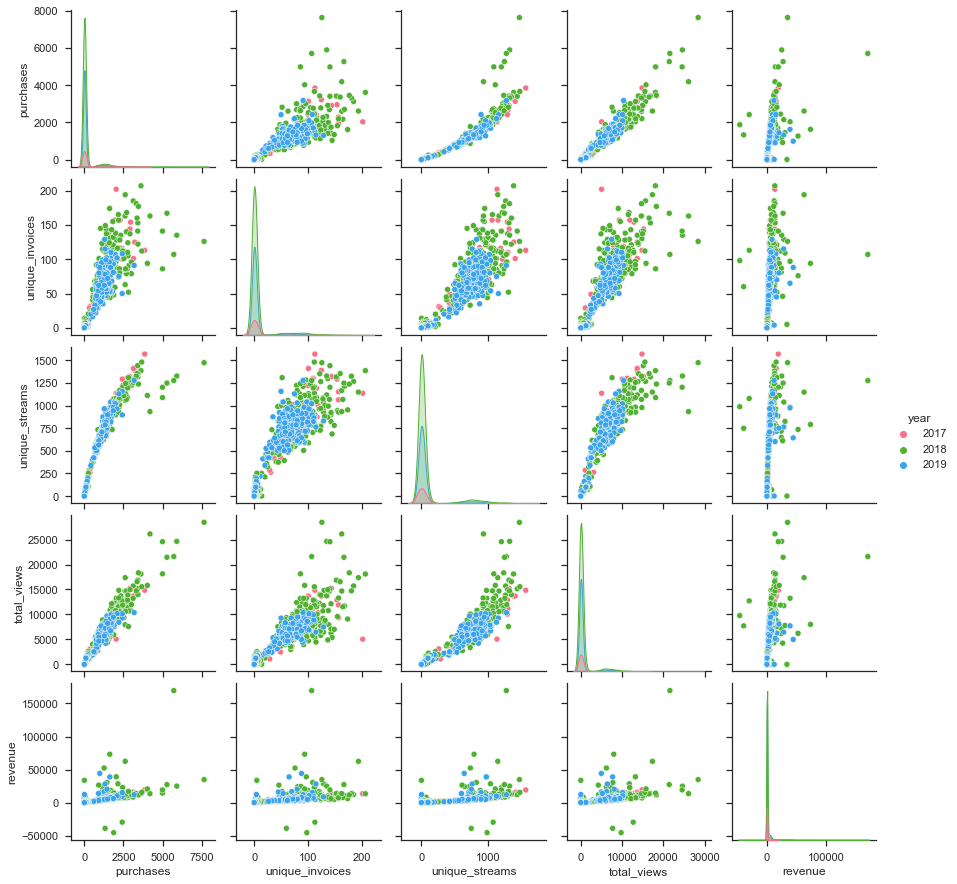

In [47]:
import seaborn as sns
sns.set(style="ticks", color_codes=True)

## make a pair plot
columns = ['purchases', 'unique_invoices', 'unique_streams', 'total_views', 'revenue']

axes = sns.pairplot(df,vars=columns,hue="year",palette="husl")